### Import MIP weights

In [16]:
import numpy as np 

folder_location = './data/'
flags_wts_file_name = 'flags-MIP-weights.npy'
flags_wts = np.load(folder_location + flags_wts_file_name)

F = len(flags_wts[0]) # 43 features
C = len(flags_wts[0][1]) # 5 classes
weights = flags_wts[0]

### Distance and CkNN functions

In [17]:
delta = 1
k = 5
 
def distance(p1,p2):
    d = 0
    for c in range(C): 
        if weights[p1][c] != weights[p2][c]: 
            d += 1 
    return d 

def weight(p1,p2): 
    w = 0 
    for c in range(C): 
        if weights[p1][c] == weights[p2][c]: 
            w += 1 
    return w 

def neighbours(a): 
    res = []
    for i in range(k): 
        for f in range(F): 
            if f != a and distance(f,a) == i:
                res.append(f)
    return res


In [18]:
all_neighbours = [] 
for f in range(F): 
    all_neighbours.append(neighbours(f))

In [19]:
from math import sqrt

def cknn(a, b, delta, k):
    rhs = 0 
    a_knn = all_neighbours[a]
    b_knn = all_neighbours[b]
    if len(a_knn) >= k and len(b_knn) >= k: 
        rhs = delta * sqrt(distance(a, a_knn[k-1]) * distance(b, b_knn[k-1]))
    else: 
        rhs = delta * sqrt(C * C)
    return rhs 


### Adjacency matrix, edges, edge weights and connected nodes

In [20]:
adj = [[0 for f1 in range(F)] for f2 in range(F)]
for f1 in range(F): 
    for f2 in range(F):
        if distance(f1,f2) < cknn(f1,f2,delta,k): 
            adj[f1][f2] = 1 

In [21]:
# remove all 0's pixels: 
remove = []

for i in range(F): 
    if list(weights[i]) == [0] * C: 
        remove.append(i)
        
remain = [i for i in range(F) if i not in remove]

In [22]:
edges = []
edge_wts = []
connected_nodes = []
for f1 in range(F): 
    for f2 in range(F): 
        if f1 != f2 and f1 in remain and f2 in remain and adj[f1][f2] == 1:
            if (f1,f2) not in edges and (f2,f1) not in edges: 
                edges.append((f1,f2))
                edge_wts.append(weight(f1,f2))
            if f1 not in connected_nodes: 
                connected_nodes.append(f1)
            if f2 not in connected_nodes: 
                connected_nodes.append(f2)

### Basic network before coloring by class

In [23]:
colors = [0 for f in range(F)]
for f in range(F): 
    if f in connected_nodes: 
        colors[f] = "red"
    else: 
        colors[f] = "white"

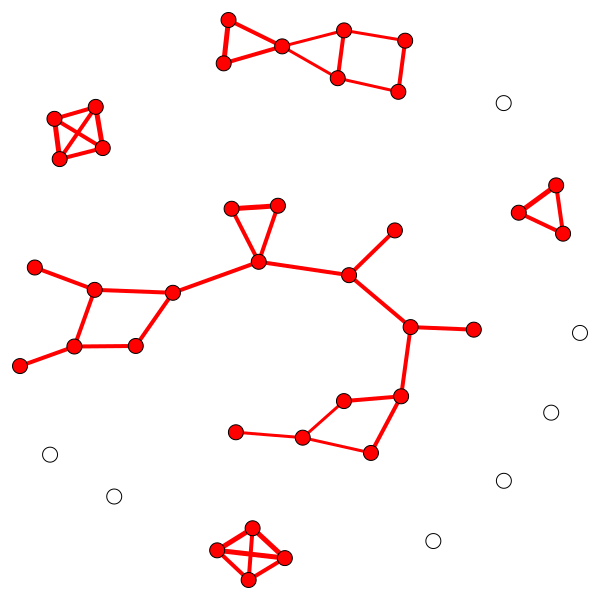

In [24]:
# blank canvas: 
# reference: https://towardsdatascience.com/newbies-guide-to-python-igraph-4e51689c35b4

import sys
import igraph as ig
from igraph import *
import re
import cairo
import random

random.seed(123)

g = Graph(n = F, edges = edges,
          vertex_attrs={'color': colors})

visual_style = {}
visual_style["vertex_size"] = 15
#visual_style["vertex_label_size"] = 5

g.es["width"] = edge_wts
g.es["color"] = "red"
#g.vs["name"] = [str(i) for i in range(F)]
#g.vs["label"] = g.vs["name"]

layout = g.layout_fruchterman_reingold() # potential


#ig.plot(g, "./cknn/flags/delta_" + str(delta) + "_k_" + str(k) + ".png", layout = layout, **visual_style)
ig.plot(g, layout = layout, **visual_style)

### Color network based on class

In [30]:
colors = [[0 for c in range(C)] for f in range(F)] 

for f in range(F): 
    for c in range(C): 
        if weights[f][c] == 1: 
            colors[f][c] = "black"
        elif weights[f][c] == -1:
            colors[f][c] = "white"
        elif weights[f][c] == 0: 
            colors[f][c] = "gray"

In [32]:
colors = [[0 for f in range(F)] for c in range(C)]
for f in range(F): 
    for c in range(C):
        if weights[f][c] == 1: 
            colors[c][f] = "black"
        elif weights[f][c] == -1:
            colors[c][f] = "white"
        else: 
            colors[c][f] = "gray"

for flags_class in range(C): 
    random.seed(123)

    g = Graph(n = F, edges = edges,
              vertex_attrs={'color': colors[flags_class]})

    visual_style = {}
    visual_style["vertex_size"] = 15
    #visual_style["vertex_label_size"] = 5

    g.es["width"] = edge_wts
    g.es["color"] = "gray"
    #g.vs["name"] = [str(i) for i in range(F)]
    #g.vs["label"] = g.vs["name"]

    layout = g.layout_fruchterman_reingold() # potential

    ig.plot(g, "./classes/class_" + str(flags_class) + ".png", layout = layout, **visual_style)
    #ig.plot(g, layout = layout, **visual_style)

### Testing on unseen observations: 

In [26]:
# mip model predictions on flags test data: 
preds_filename = "mip_flags_model_predictions.npy"
xtest_filename = 'x_test_flags_10.npy'
ytest_filename = 'y_test_flags_10.npy'
flags_model_preds = np.load(folder_location + preds_filename)
x_test = np.load(folder_location + xtest_filename)
y_test = np.load(folder_location + ytest_filename)

# coloring system: 
N = len(y_test)

#colors = [[0 for i in range(N)] for f in range(F_flags)] 
colors_obs = [[0 for f in range(F)] for i in range(N)] 

for i in range(N): 
    for f in range(F): 
        if x_test[i][f] > 0: 
            colors_obs[i][f] = "black"
        elif x_test[i][f] == 0: 
            colors_obs[i][f] = "white"

In [43]:
colors_obs = [[0 for f in range(F)] for i in range(N)] 

for i in range(N): 
    for f in range(F): 
        if x_test[i][f] > 0: 
            colors_obs[i][f] = "black"
        elif x_test[i][f] == 0: 
            colors_obs[i][f] = "white"

In [135]:
obs = random.randint(0,N-1)
obs 

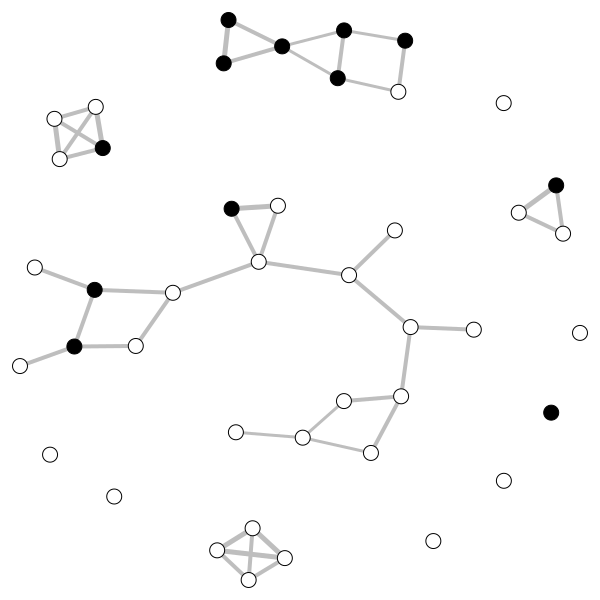

In [138]:
# n: number of vertices 
# edges: adjacency matrix
# edge_attrs: edge weights 

random.seed(123)

# specify the observation: 


g = Graph(n = F, edges = edges,vertex_attrs={'color':[colors_obs[obs][i] for i in range(F)]})

visual_style = {}
visual_style["vertex_size"] = 15
#visual_style["vertex_label_size"] = 5

g.es["width"] = edge_wts
g.es["color"] = "gray"
#g.vs["name"] = [str(i) for i in range(F)]
#g.vs["label"] = g.vs["name"]

layout = g.layout_fruchterman_reingold() # potential

ig.plot(g, layout = layout, **visual_style)
#ig.plot(g, "./unseen.png", layout = layout, **visual_style)

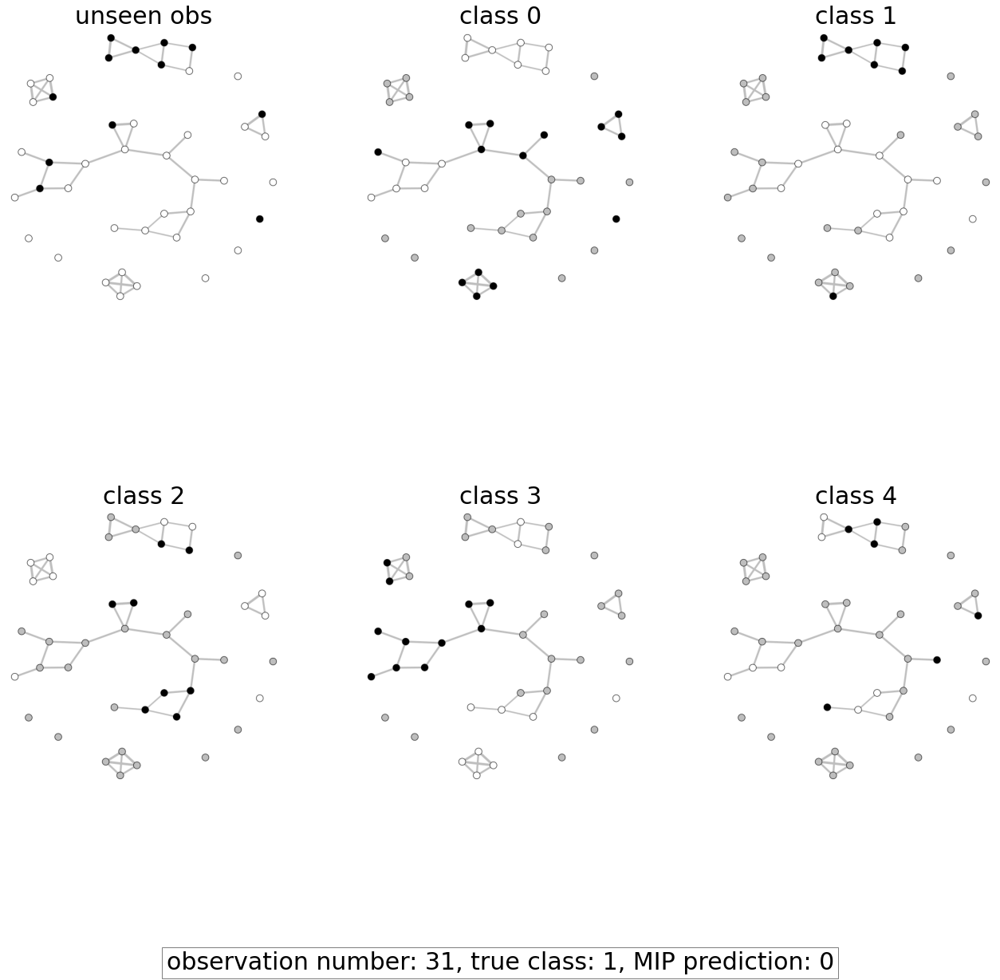

In [140]:
from PIL import Image
from matplotlib import pyplot as plt

# create figure
fig = plt.figure(figsize=(20, 20))
  
# setting values to rows and column variables
rows = 2
columns = 3
  

# get images   
img0 = Image.open("./unseen.png")
img1 = Image.open("./classes/class_0.png")
img2 = Image.open("./classes/class_1.png")
img3 = Image.open("./classes/class_2.png")
img4 = Image.open("./classes/class_3.png")
img5 = Image.open("./classes/class_4.png")

# Adds a subplot at the 1st position
fig.add_subplot(rows, columns, 1)
plt.imshow(img0)
plt.axis('off')
plt.title("unseen obs", fontsize = 30)
  
# Adds a subplot at the 2nd position
fig.add_subplot(rows, columns, 2)
plt.imshow(img1)
plt.axis('off')
plt.title("class 0", fontsize = 30)
  
# Adds a subplot at the 3rd position
fig.add_subplot(rows, columns, 3)
plt.imshow(img2)
plt.axis('off')
plt.title("class 1", fontsize = 30)
  
# Adds a subplot at the 4th position
fig.add_subplot(rows, columns, 4)
plt.imshow(img3)
plt.axis('off')
plt.title("class 2", fontsize = 30)

# Adds a subplot at the 5th position
fig.add_subplot(rows, columns, 5)
plt.imshow(img4)
plt.axis('off')
plt.title("class 3", fontsize = 30)

# Adds a subplot at the 6th position
fig.add_subplot(rows, columns, 6)
plt.imshow(img5)
plt.axis('off')
plt.title("class 4", fontsize = 30)

#plt.savefig('all_classes.png')
fig.tight_layout(pad = 10)
plt.figtext(0.5, 0.01, "observation number: " + str(obs) + ", true class: " + str(int(y_test[obs])) + ", MIP prediction: " + str(flags_model_preds[obs][0]) , ha="center", fontsize=30, bbox={"facecolor":"white", "alpha":0.5, "pad":5})
#plt.savefig('./predictions/obs_' + str(obs) + '.png')
plt.show()

### Generate networks for all observations and save in specified folder

<ipython-input-378-a71c5a7cd016>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20, 20))


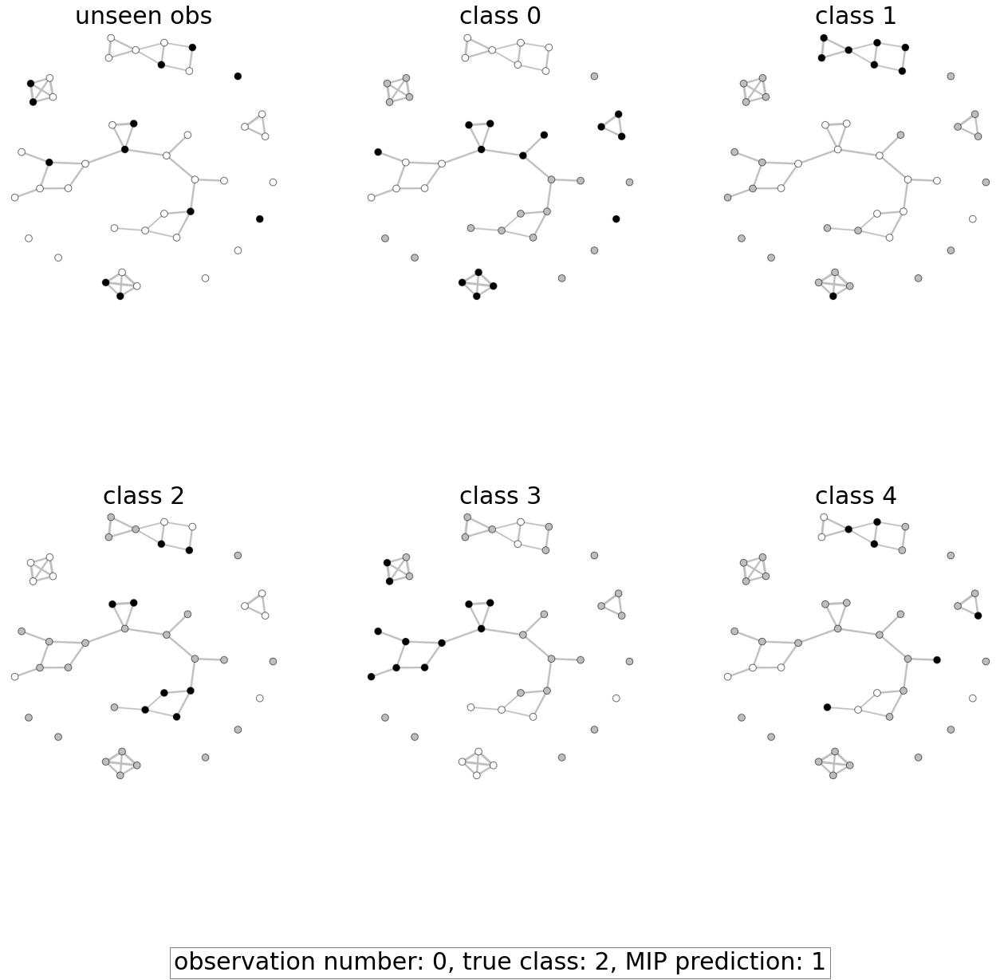

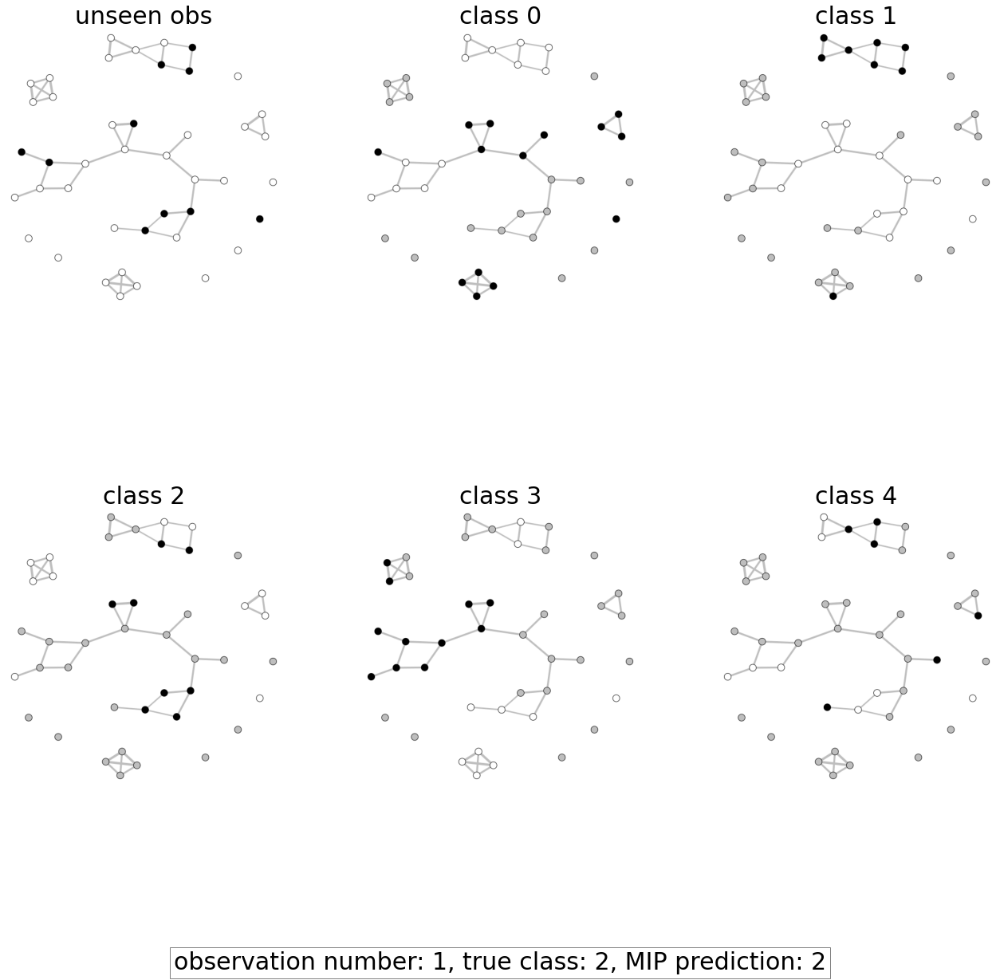

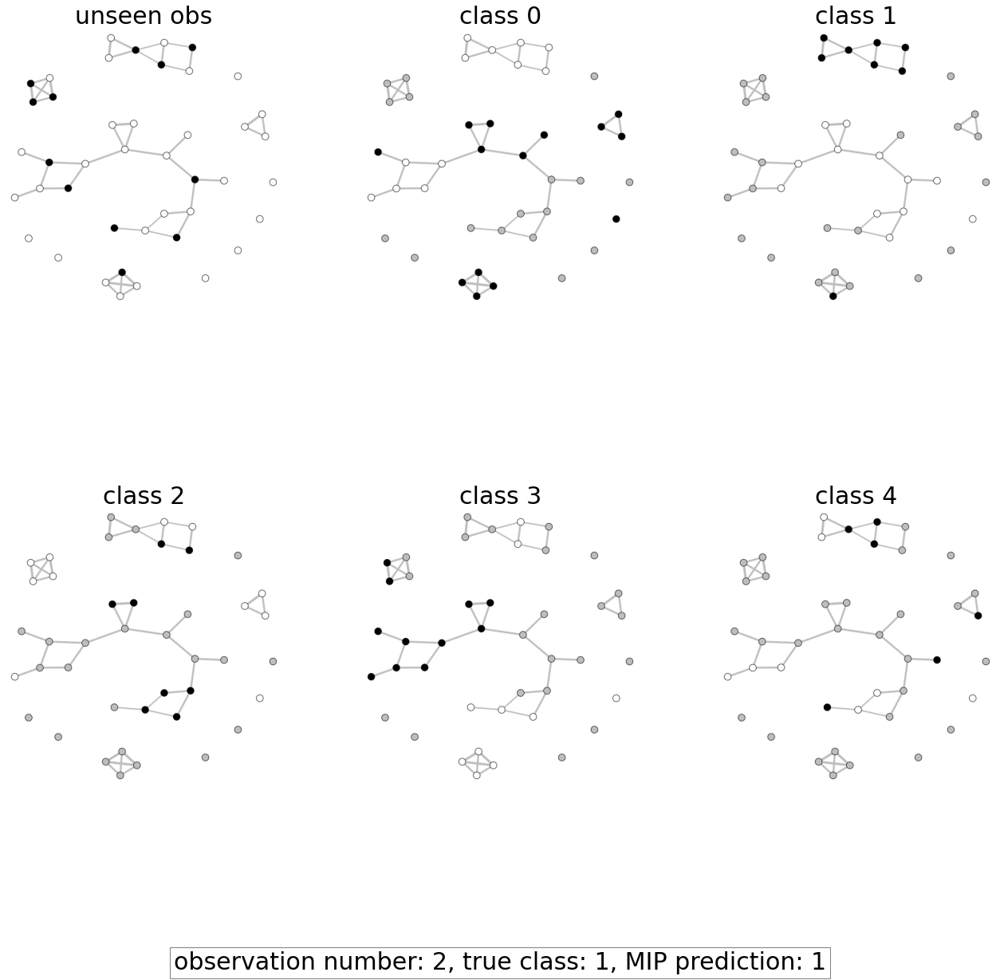

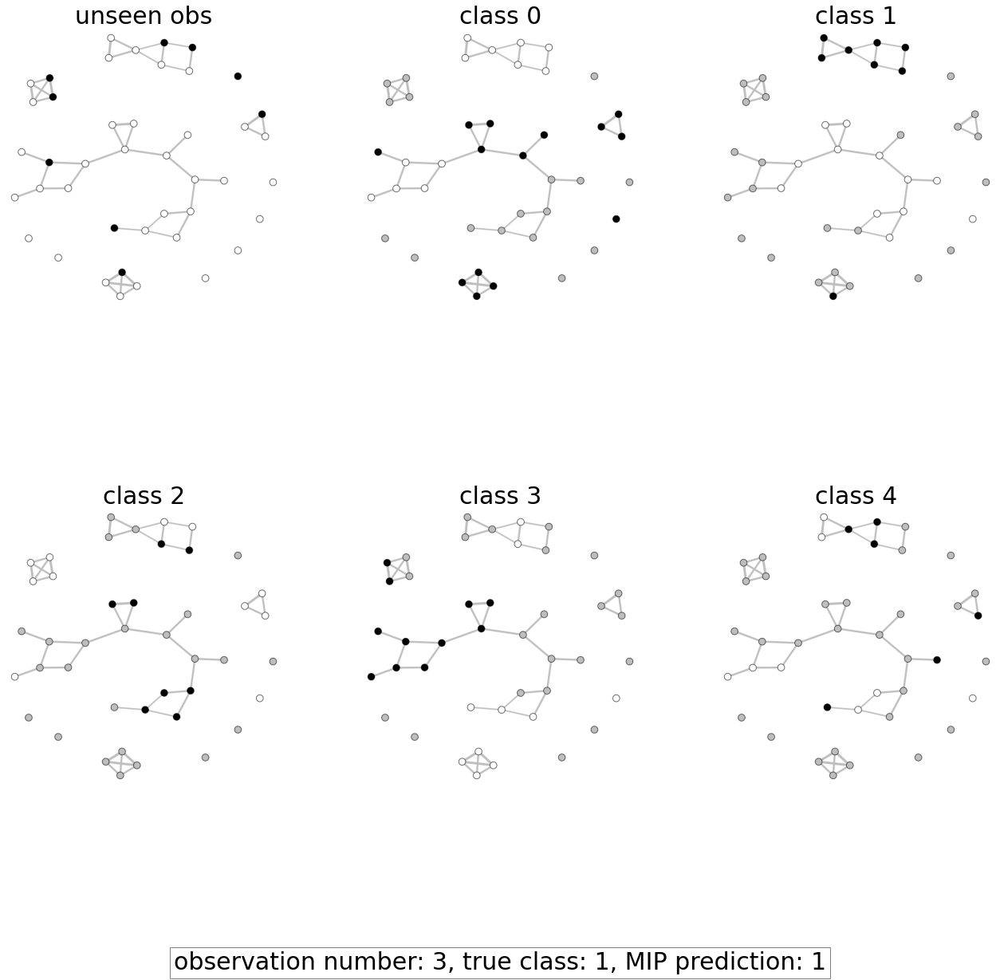

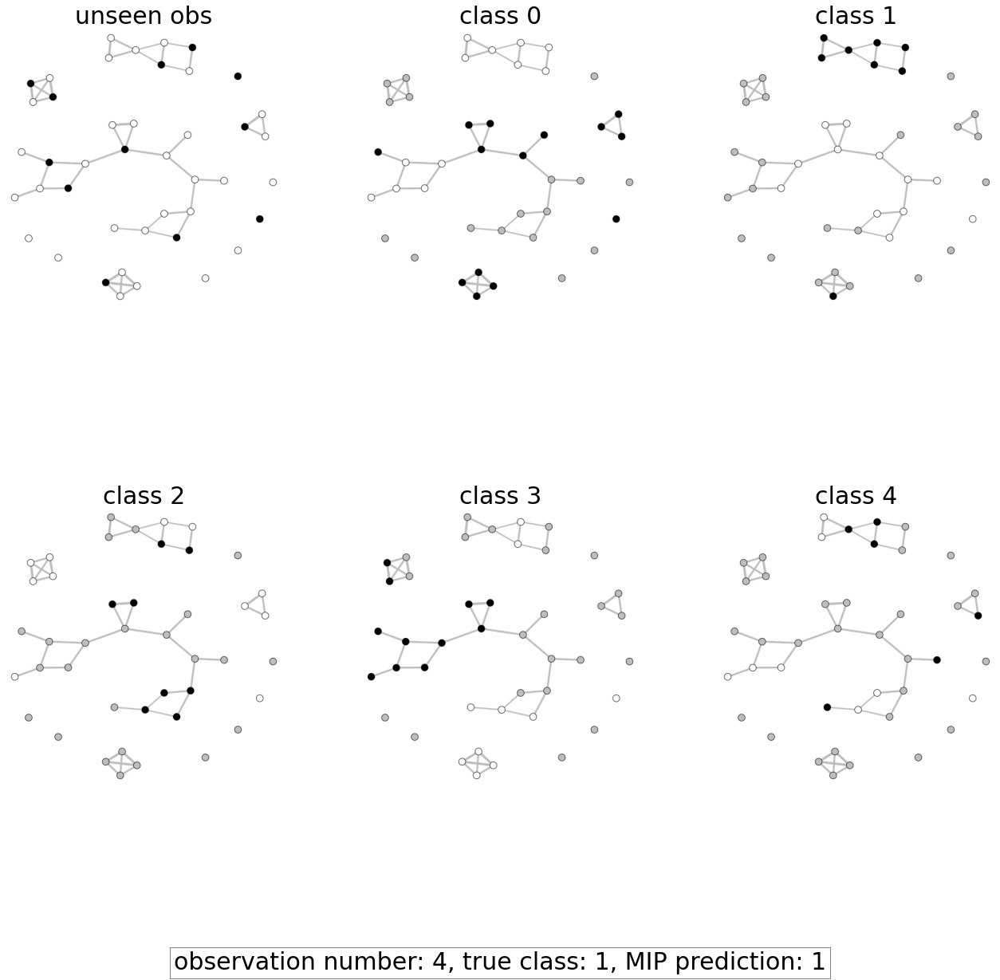

...

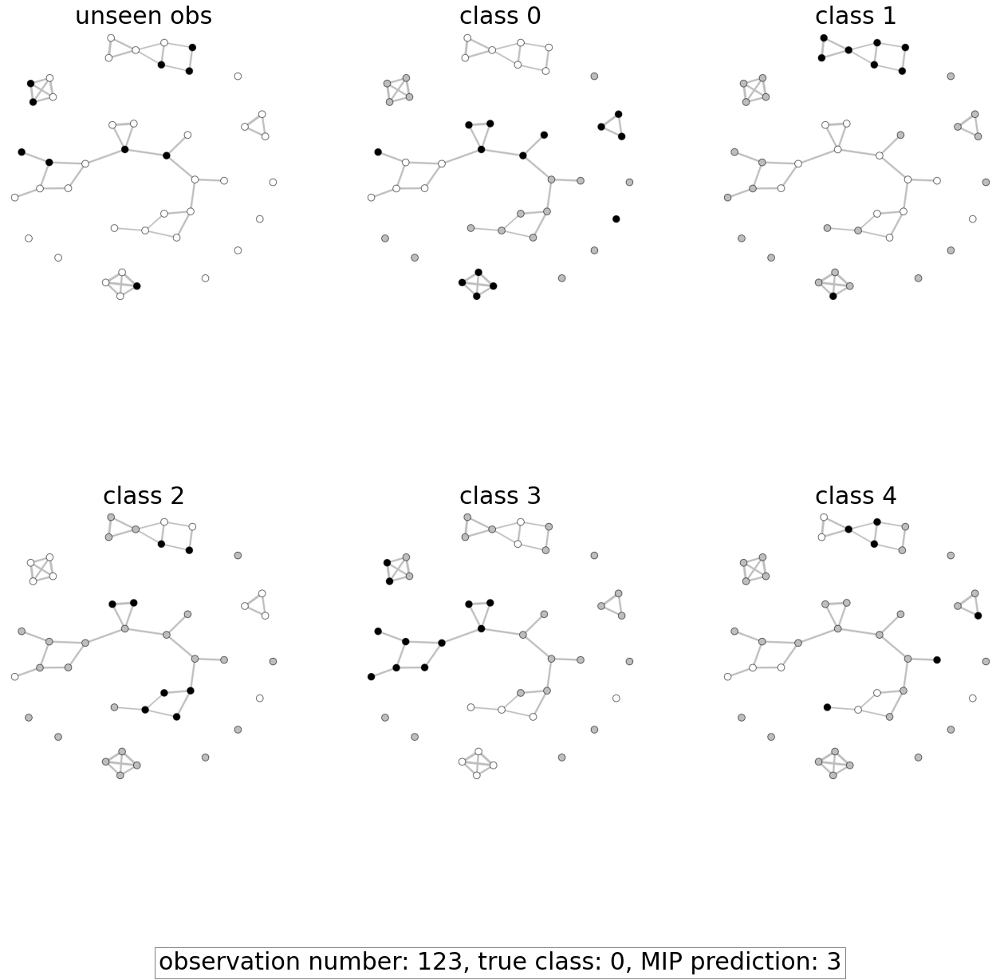

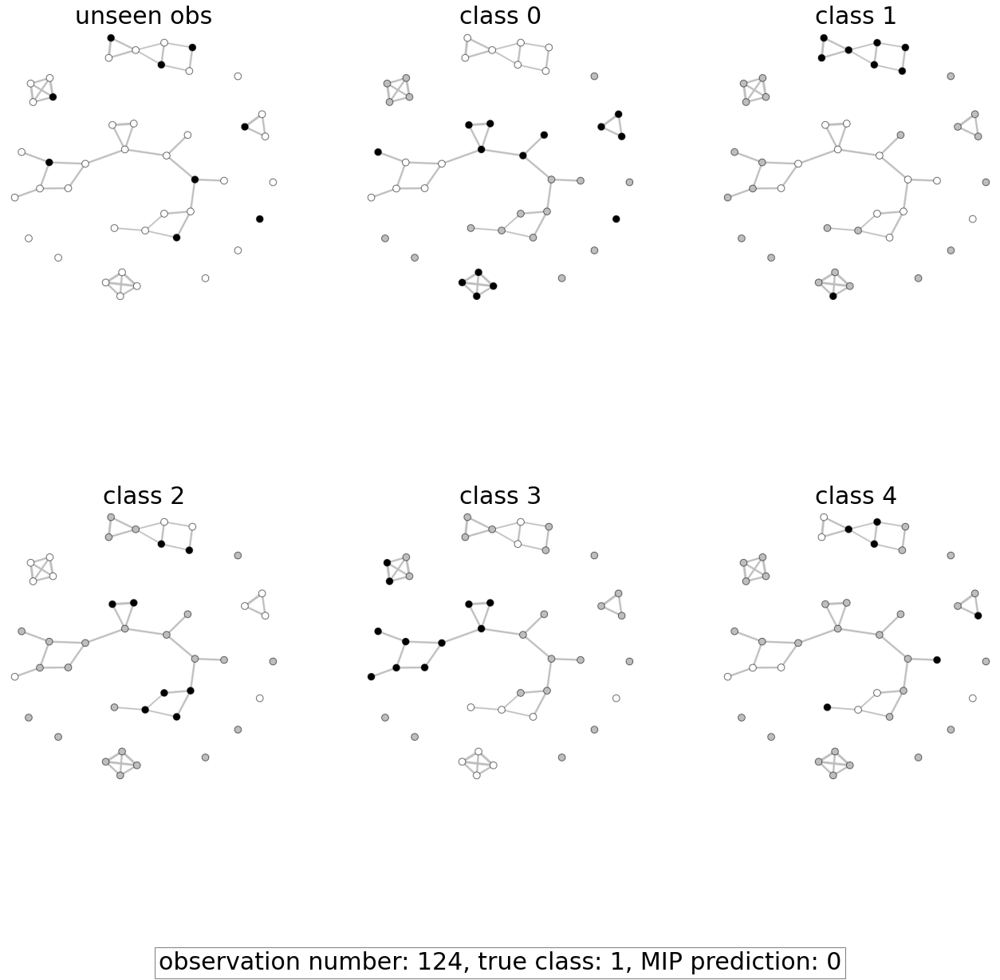

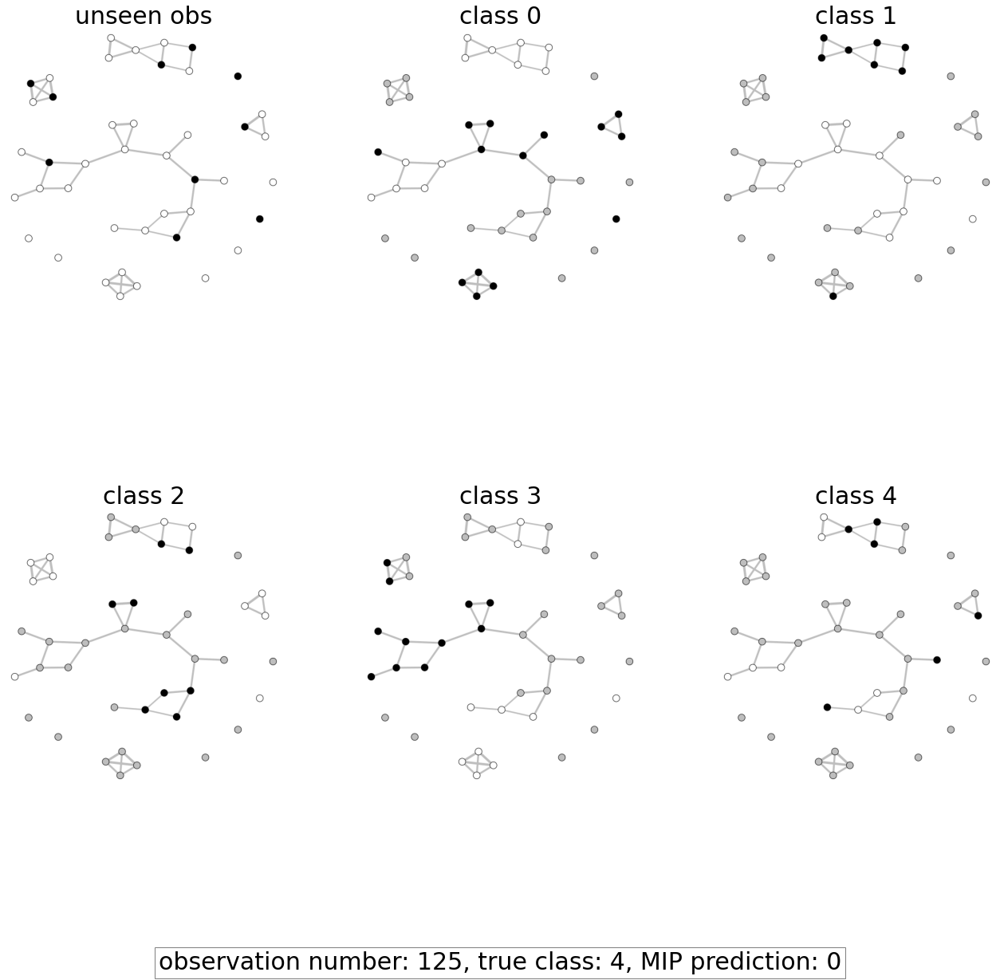

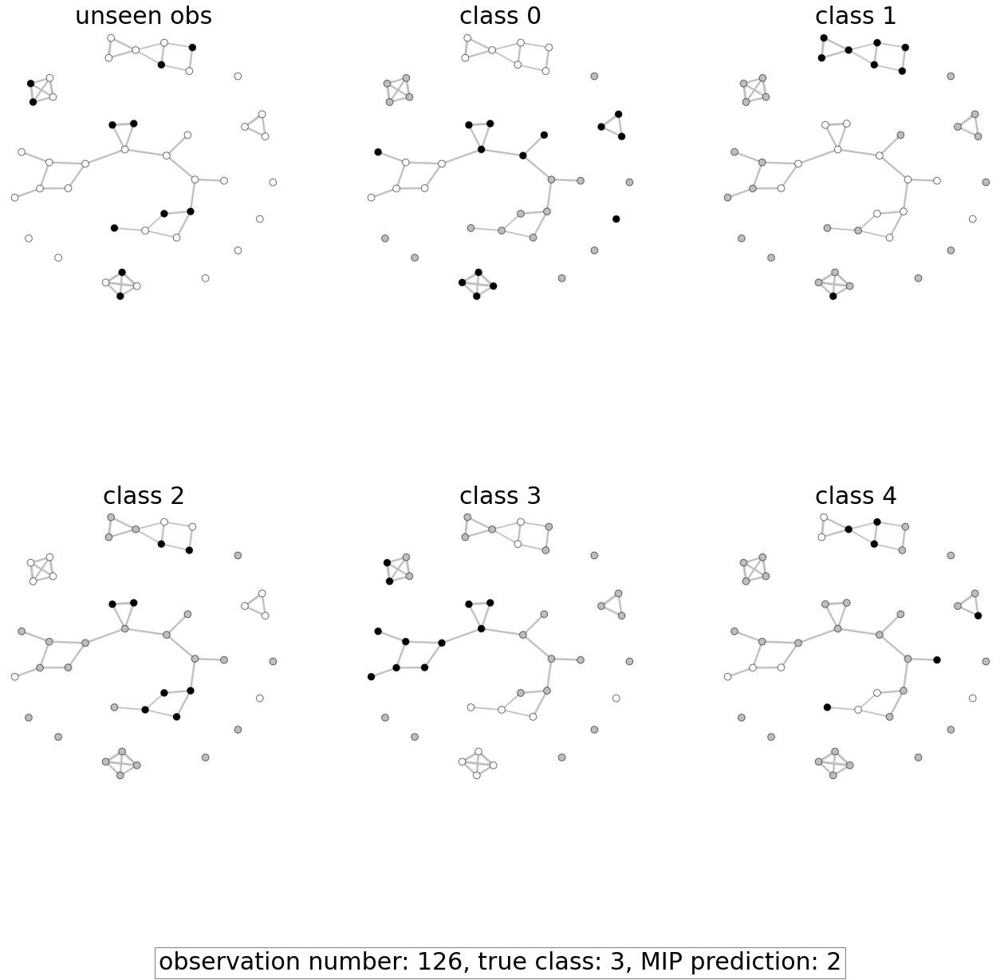

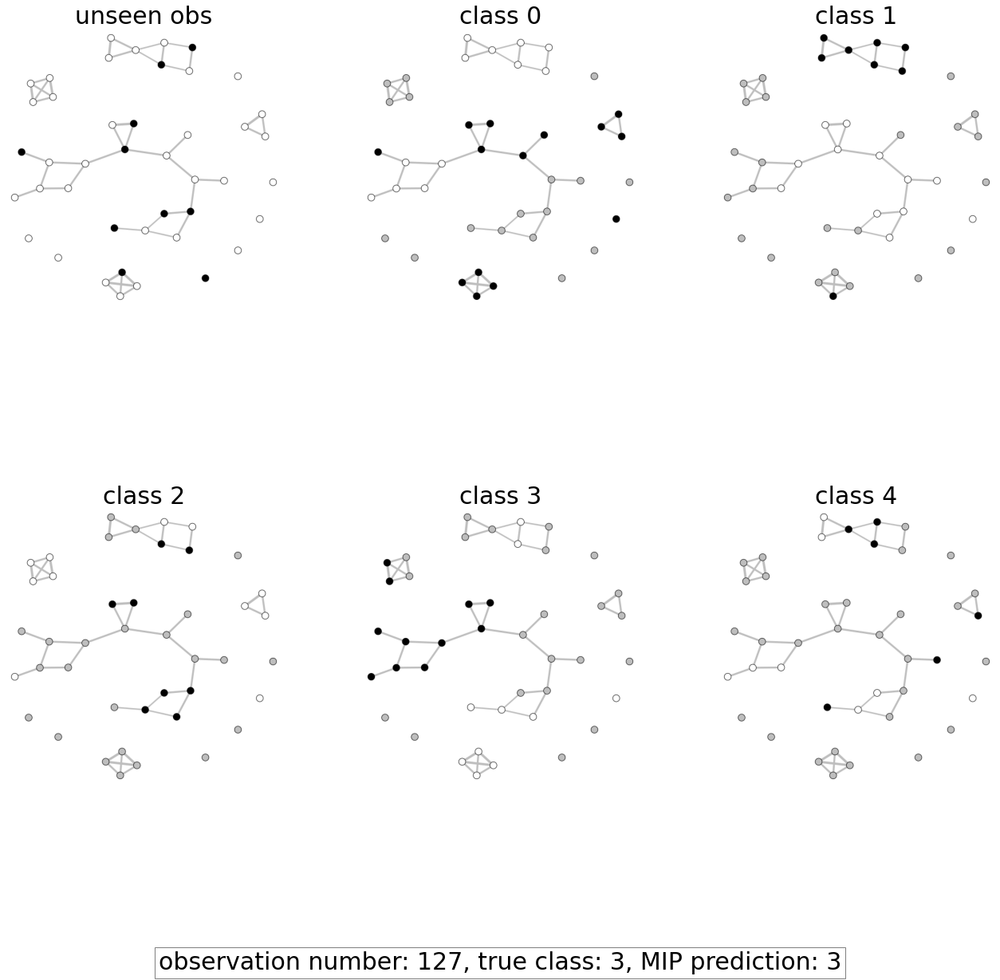

In [378]:
# n: number of vertices 
# edges: adjacency matrix
# edge_attrs: edge weights 

for obs in range(len(x_test)): 
    random.seed(123)
    g = Graph(n = F, edges = edges,
              vertex_attrs={'color': [colors_obs[obs][i] for i in range(F)]})

    visual_style = {}
    visual_style["vertex_size"] = 15

    g.es["width"] = edge_wts
    g.es["color"] = "gray"

    layout = g.layout_fruchterman_reingold() # potential

    #ig.plot(g, layout = layout, **visual_style)
    ig.plot(g, "./unseen/unseen_" + str(obs) + ".png", layout = layout, **visual_style)

    # create figure
    fig = plt.figure(figsize=(20, 20))

    # setting values to rows and column variables
    rows = 2
    columns = 3


    # get images   
    img0 = Image.open("./unseen/unseen_" + str(obs) + ".png")
    img1 = Image.open("./classes/class_0.png")
    img2 = Image.open("./classes/class_1.png")
    img3 = Image.open("./classes/class_2.png")
    img4 = Image.open("./classes/class_3.png")
    img5 = Image.open("./classes/class_4.png")

    # Adds a subplot at the 1st position
    fig.add_subplot(rows, columns, 1)
    plt.imshow(img0)
    plt.axis('off')
    plt.title("unseen obs", fontsize = 30)

    # Adds a subplot at the 2nd position
    fig.add_subplot(rows, columns, 2)
    plt.imshow(img1)
    plt.axis('off')
    plt.title("class 0", fontsize = 30)

    # Adds a subplot at the 3rd position
    fig.add_subplot(rows, columns, 3)
    plt.imshow(img2)
    plt.axis('off')
    plt.title("class 1", fontsize = 30)

    # Adds a subplot at the 4th position
    fig.add_subplot(rows, columns, 4)
    plt.imshow(img3)
    plt.axis('off')
    plt.title("class 2", fontsize = 30)

    # Adds a subplot at the 5th position
    fig.add_subplot(rows, columns, 5)
    plt.imshow(img4)
    plt.axis('off')
    plt.title("class 3", fontsize = 30)

    # Adds a subplot at the 6th position
    fig.add_subplot(rows, columns, 6)
    plt.imshow(img5)
    plt.axis('off')
    plt.title("class 4", fontsize = 30)

    #plt.savefig('all_classes.png')
    fig.tight_layout(pad = 10)
    plt.figtext(0.5, 0.01, "observation number: " + str(obs) + ", true class: " + str(int(y_test[obs])) + ", MIP prediction: " + str(flags_model_preds[obs][0]) , ha="center", fontsize=30, bbox={"facecolor":"white", "alpha":0.5, "pad":5})
    plt.savefig('./predictions/predictions/obs_' + str(obs) + '.png')

### Plot for paper

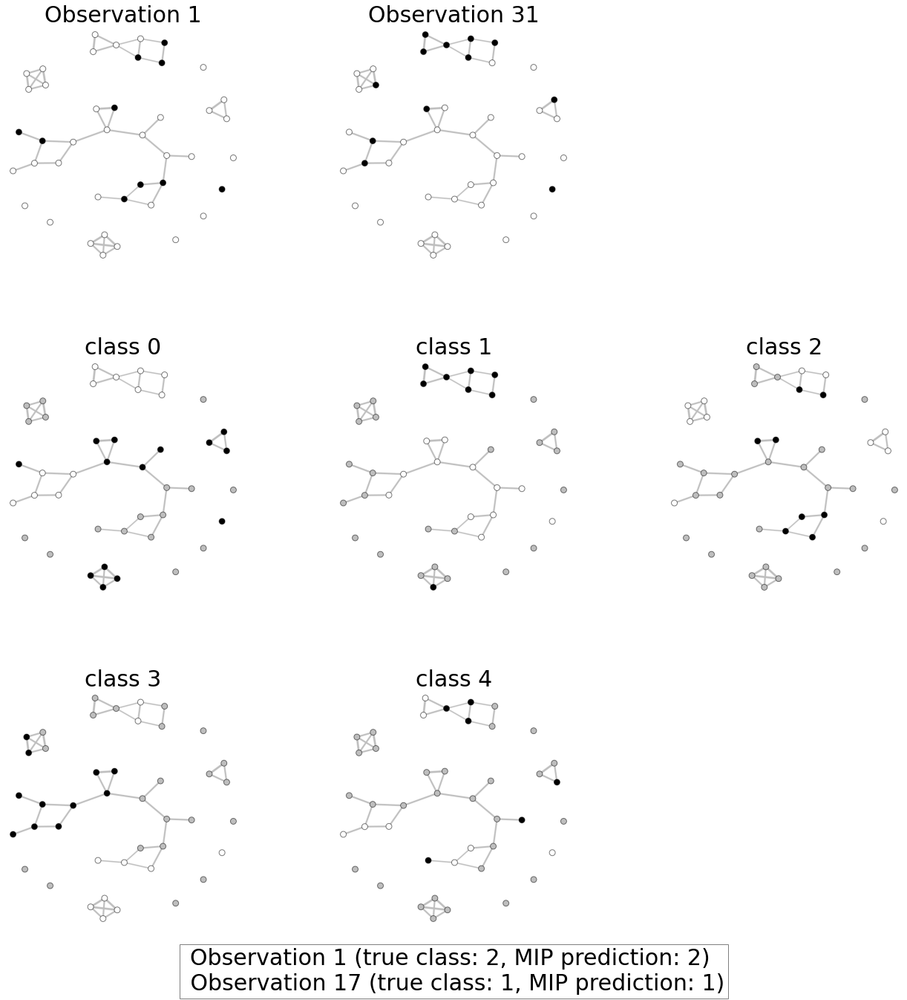

In [391]:
from PIL import Image
from matplotlib import pyplot as plt

# create figure
fig = plt.figure(figsize=(20, 20))
  
# setting values to rows and column variables
rows = 3
columns = 3
  

# get images   
img0 = Image.open("./unseen/unseen_1.png")
img00 = Image.open("./unseen/unseen_31.png")
img1 = Image.open("./classes/class_0.png")
img2 = Image.open("./classes/class_1.png")
img3 = Image.open("./classes/class_2.png")
img4 = Image.open("./classes/class_3.png")
img5 = Image.open("./classes/class_4.png")

# Adds a subplot at the 1st position
fig.add_subplot(rows, columns, 1)
plt.imshow(img0)
plt.axis('off')
plt.title("Observation 1", fontsize = 30)

# Adds a subplot at the 1st position
fig.add_subplot(rows, columns, 2)
plt.imshow(img00)
plt.axis('off')
plt.title("Observation 31", fontsize = 30)
  
# Adds a subplot at the 2nd position
fig.add_subplot(rows, columns, 4)
plt.imshow(img1)
plt.axis('off')
plt.title("class 0", fontsize = 30)
  
# Adds a subplot at the 3rd position
fig.add_subplot(rows, columns, 5)
plt.imshow(img2)
plt.axis('off')
plt.title("class 1", fontsize = 30)
  
# Adds a subplot at the 4th position
fig.add_subplot(rows, columns, 6)
plt.imshow(img3)
plt.axis('off')
plt.title("class 2", fontsize = 30)

# Adds a subplot at the 5th position
fig.add_subplot(rows, columns, 7)
plt.imshow(img4)
plt.axis('off')
plt.title("class 3", fontsize = 30)

# Adds a subplot at the 6th position
fig.add_subplot(rows, columns, 8)
plt.imshow(img5)
plt.axis('off')
plt.title("class 4", fontsize = 30)

#plt.savefig('all_classes.png')
fig.tight_layout(pad = 10)
plt.figtext(0.5, 0.01, "Observation 1 (true class: " + str(int(y_test[1])) + ", MIP prediction: " + str(flags_model_preds[1][0]) + ") \n Observation 17 (true class: " + str(int(y_test[17])) + ", MIP prediction: " + str(flags_model_preds[17][0]) + ")", ha="center", fontsize=30, bbox={"facecolor":"white", "alpha":0.5, "pad":5})
plt.savefig('./flags-paper/flags_predictions.png')
plt.show()